# Mask of border

In [5]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F
import blobfile as bf
import PIL


plt.rcParams["savefig.bbox"] = 'tight'


def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    # print(imgs.shape)
    for i, img in enumerate(imgs):
        img = img.detach()
        # img = F.to_pil_image(img)
        img = Image.fromarray(img)
        # print(np.max(img), np.min(img), np.mean(img))
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])


def load_image(path):
    with bf.BlobFile(path, "rb") as f:
        pil_image = PIL.Image.open(f)
        pil_image.load()
    pil_image = pil_image.convert("RGB")
    return pil_image

def face_segment(segment_part, img_name):
    # print(self.kwargs.keys())
    # print(self.kwargs['in_image_for_cond'].keys())
    # exit()
    face_segment_anno = load_image(img_name)
    
    face_segment_anno = np.array(face_segment_anno)
    bg = (face_segment_anno == 0)
    skin = (face_segment_anno == 1)
    l_brow = (face_segment_anno == 2)
    r_brow = (face_segment_anno == 3)
    l_eye = (face_segment_anno == 4)
    r_eye = (face_segment_anno == 5)
    eye_g = (face_segment_anno == 6)
    l_ear = (face_segment_anno == 7)
    r_ear = (face_segment_anno == 8)
    ear_r = (face_segment_anno == 9)
    nose = (face_segment_anno == 10)
    mouth = (face_segment_anno == 11)
    u_lip = (face_segment_anno == 12)
    l_lip = (face_segment_anno == 13)
    neck = (face_segment_anno == 14)
    neck_l = (face_segment_anno == 15)
    cloth = (face_segment_anno == 16)
    hair = (face_segment_anno == 17)
    hat = (face_segment_anno == 18)
    face = np.logical_or.reduce((skin, l_brow, r_brow, l_eye, r_eye, eye_g, l_ear, r_ear, ear_r, nose, mouth, u_lip, l_lip))

    if segment_part == 'faceseg_face':
        seg_m = face
    elif segment_part == 'faceseg_head':
        seg_m = (face | neck | hair)
    elif segment_part == 'faceseg_nohead':
        seg_m = ~(face | neck | hair)
    elif segment_part == 'faceseg_face&hair':
        seg_m = ~bg
    elif segment_part == 'faceseg_bg_noface&nohair':
        seg_m = (bg | hat | neck | neck_l | cloth) 
    elif segment_part == 'faceseg_bg&ears_noface&nohair':
        seg_m = (bg | hat | neck | neck_l | cloth) | (l_ear | r_ear | ear_r)
    elif segment_part == 'faceseg_bg':
        seg_m = bg
    elif segment_part == 'faceseg_bg&noface':
        seg_m = (bg | hair | hat | neck | neck_l | cloth)
    elif segment_part == 'faceseg_hair':
        seg_m = hair
    elif segment_part == 'faceseg_faceskin':
        seg_m = skin
    elif segment_part == 'faceseg_faceskin&nose':
        seg_m = (skin | nose)
    elif segment_part == 'faceseg_face_noglasses':
        seg_m = (~eye_g & face)
    elif segment_part == 'faceseg_face_noglasses_noeyes':
        seg_m = (~(l_eye | r_eye) & ~eye_g & face)
    elif segment_part == 'faceseg_eyes&glasses':
        seg_m = (l_eye | r_eye | eye_g)
    elif segment_part == 'faceseg_eyes':
        seg_m = (l_eye | r_eye)
    # elif (segment_part == 'sobel_bg_mask') or (segment_part == 'laplacian_bg_mask') or (segment_part == 'sobel_bin_bg_mask'):
    elif segment_part in ['sobel_bg_mask', 'laplacian_bg_mask', 'sobel_bin_bg_mask']:
        seg_m = ~(face | neck | hair)
    elif segment_part in ['canny_edge_bg_mask']:
        seg_m = ~(face | neck | hair) | (l_ear | r_ear)
    else: raise NotImplementedError(f"Segment part: {segment_part} is not found!")
    
    out = seg_m
    return out

  0%|          | 0/10009 [00:00<?, ?it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  249 3
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


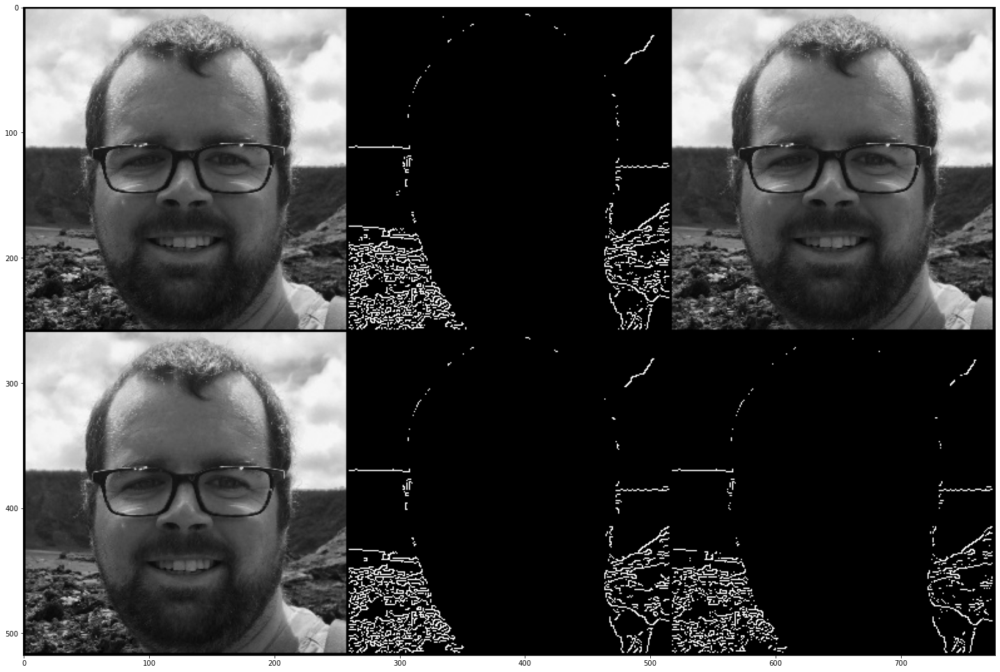

  0%|          | 1/10009 [00:00<1:12:24,  2.30it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  253 1
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


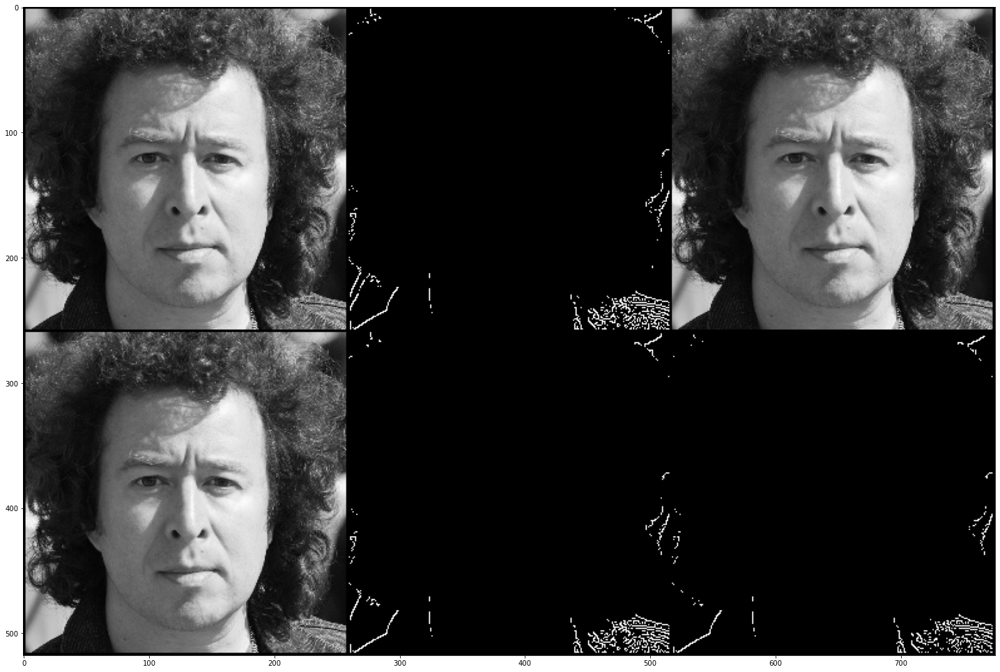

  0%|          | 2/10009 [00:00<1:12:00,  2.32it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  253 1
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


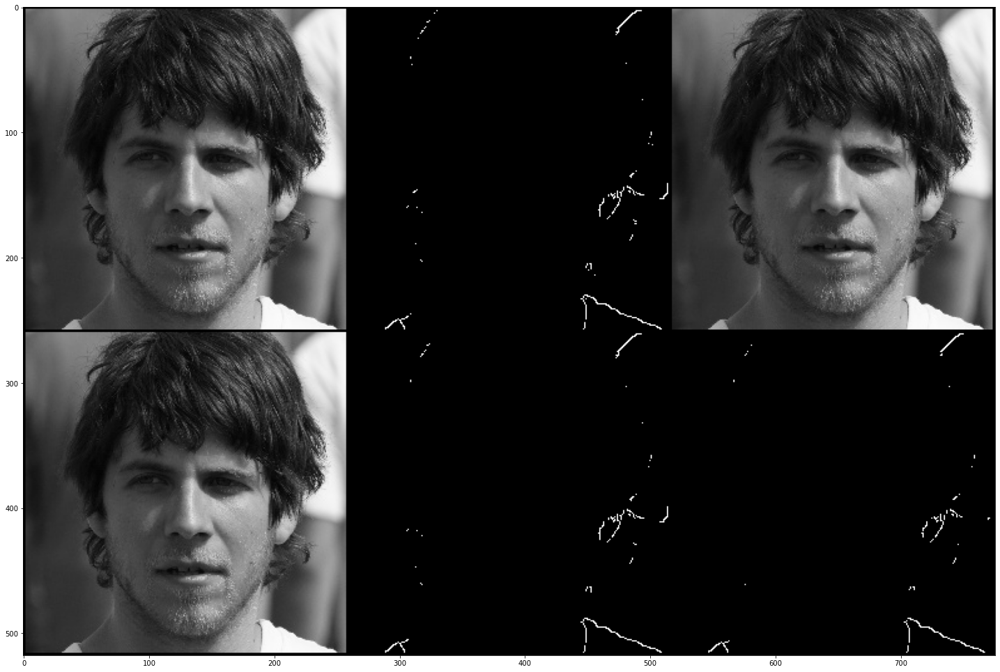

  0%|          | 3/10009 [00:01<1:17:26,  2.15it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  250 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


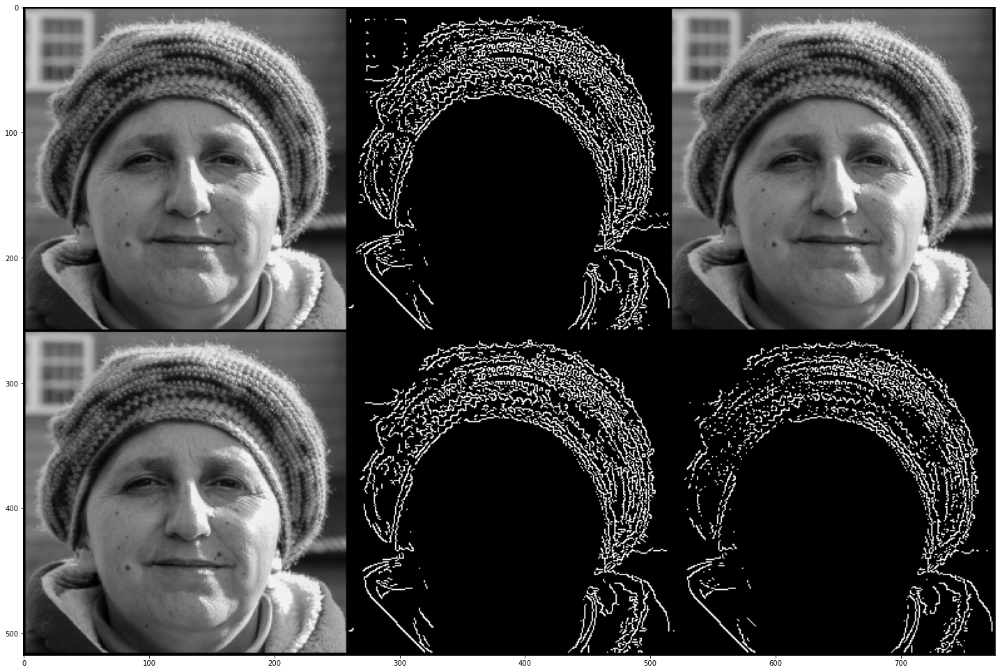

  0%|          | 4/10009 [00:01<1:16:21,  2.18it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


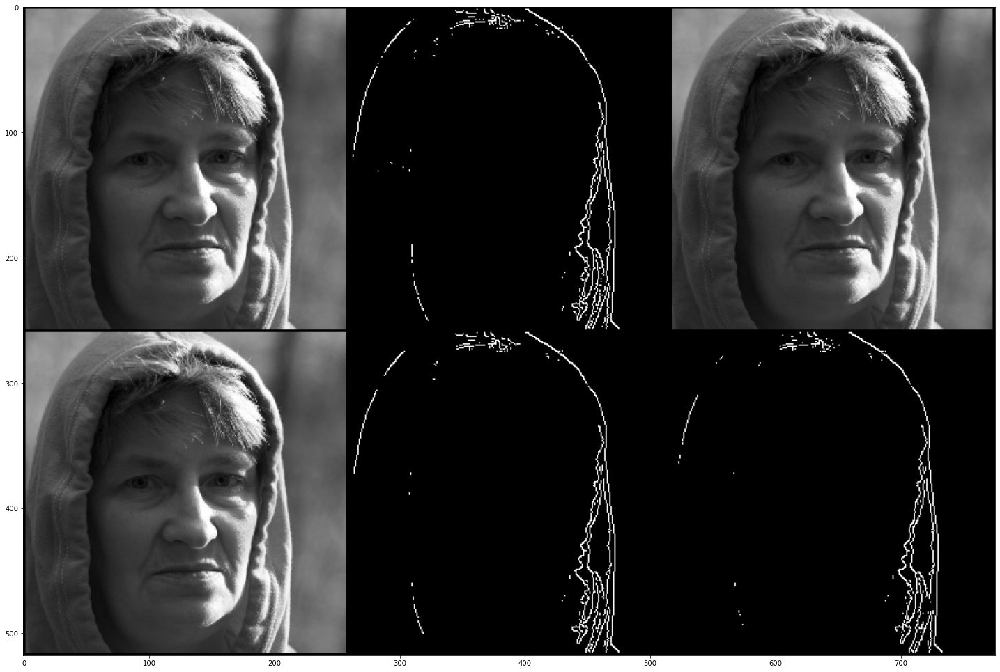

  0%|          | 5/10009 [00:02<1:13:50,  2.26it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


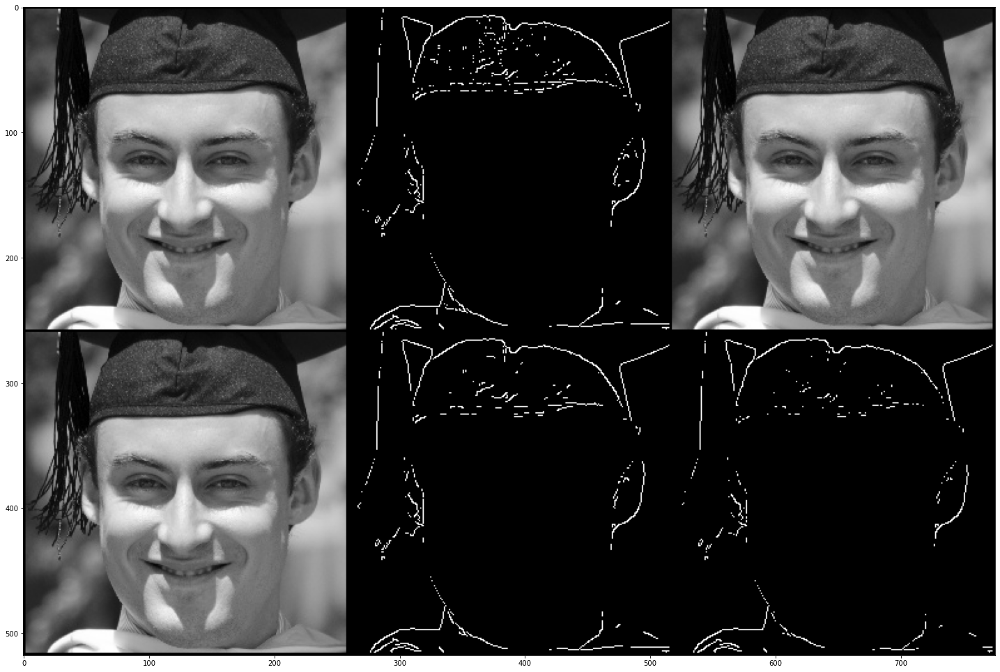

  0%|          | 6/10009 [00:02<1:12:39,  2.29it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 1
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


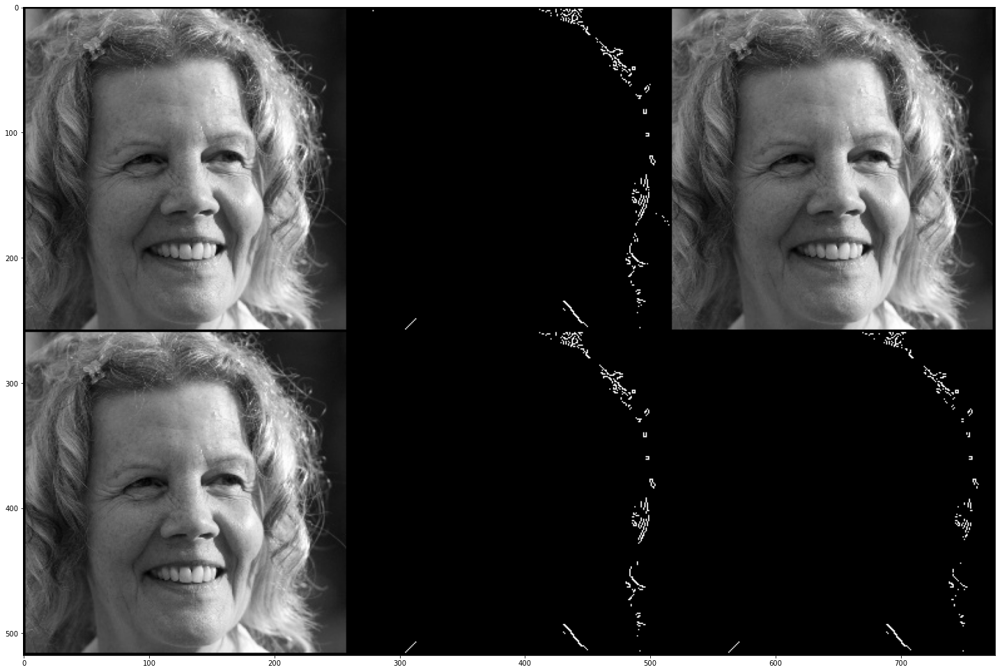

  0%|          | 7/10009 [00:03<1:13:31,  2.27it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


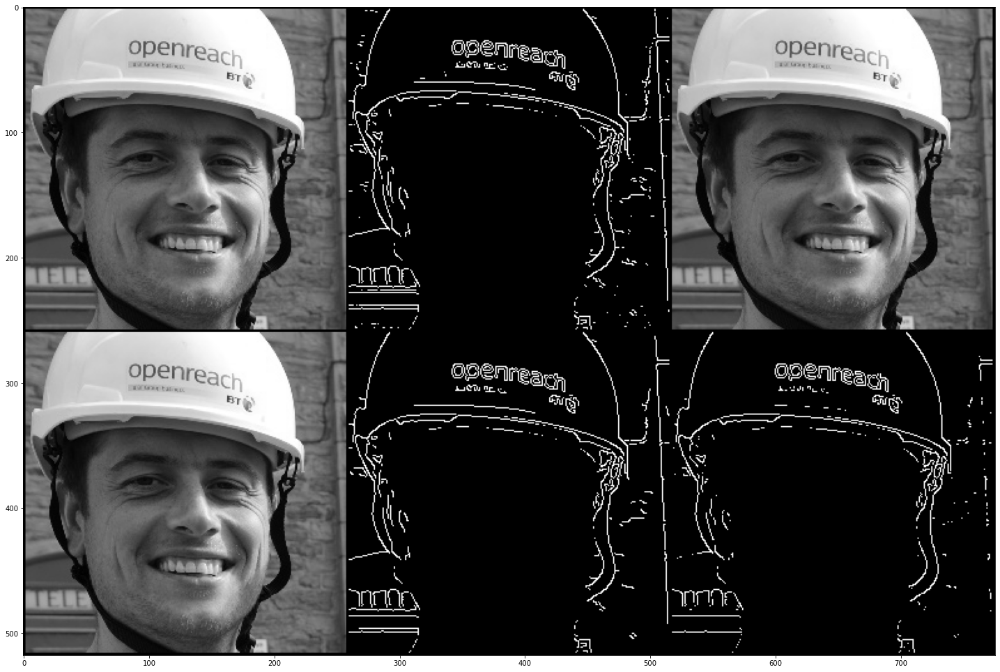

  0%|          | 8/10009 [00:03<1:13:35,  2.27it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 2
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


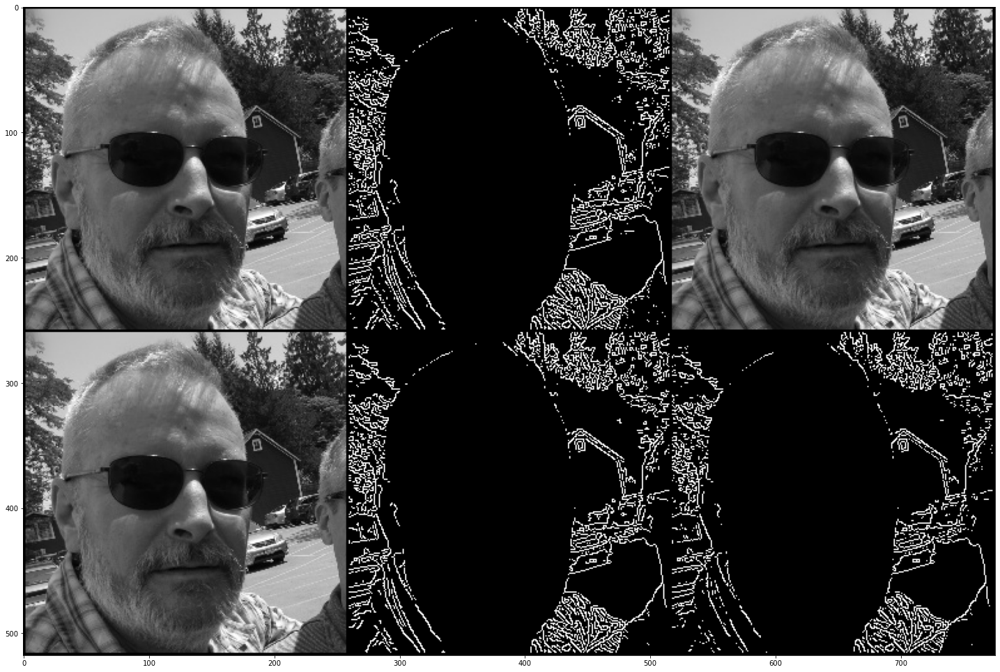

  0%|          | 9/10009 [00:04<1:14:17,  2.24it/s]

Max-Min of load image:  255 3
Img Shape:  (256, 256, 3)
Max-Min of grey image:  254 15
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


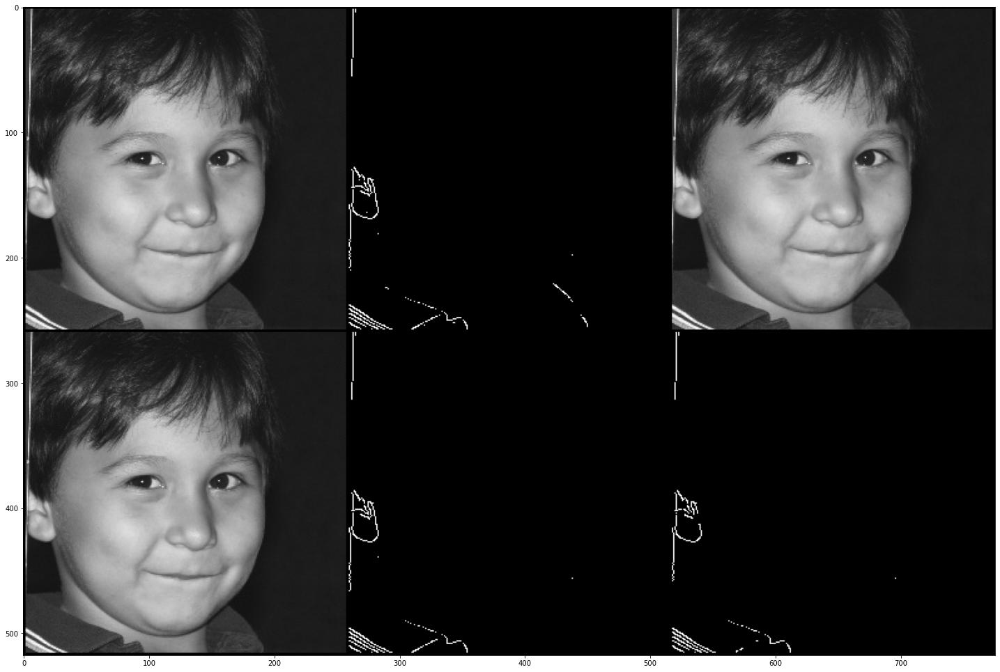

  0%|          | 10/10009 [00:04<1:12:29,  2.30it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


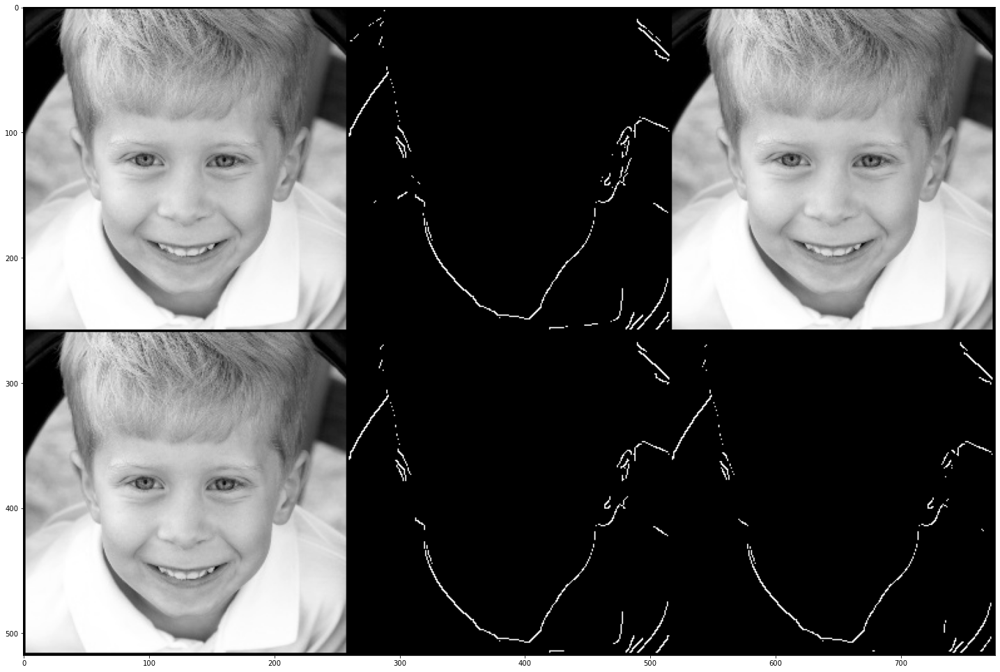

  0%|          | 11/10009 [00:05<1:24:49,  1.96it/s]

Max-Min of load image:  255 7
Img Shape:  (256, 256, 3)
Max-Min of grey image:  249 20
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


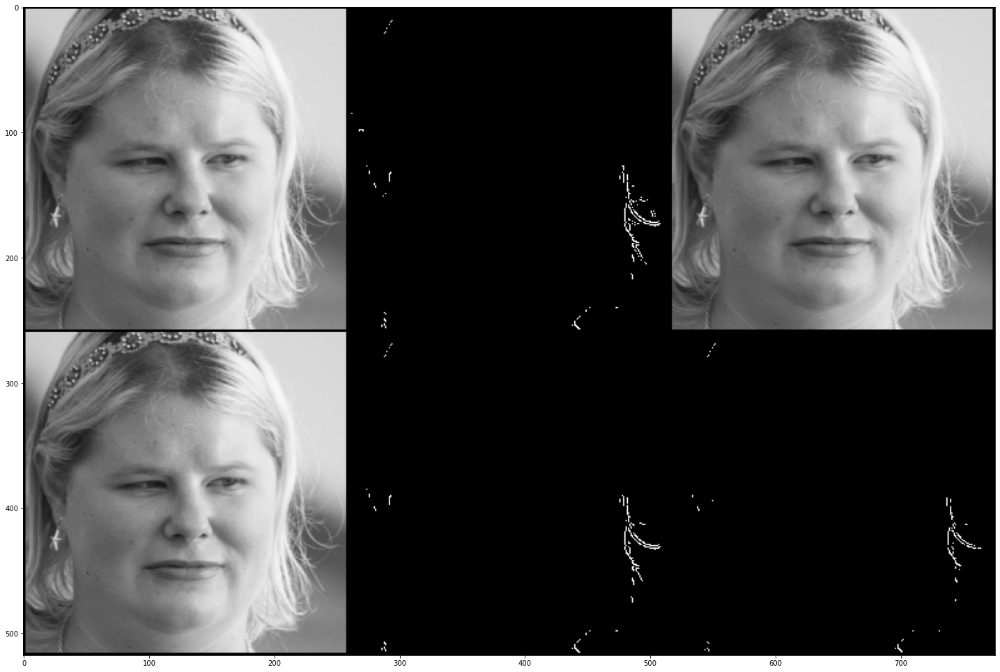

  0%|          | 12/10009 [00:05<1:21:45,  2.04it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  252 2
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


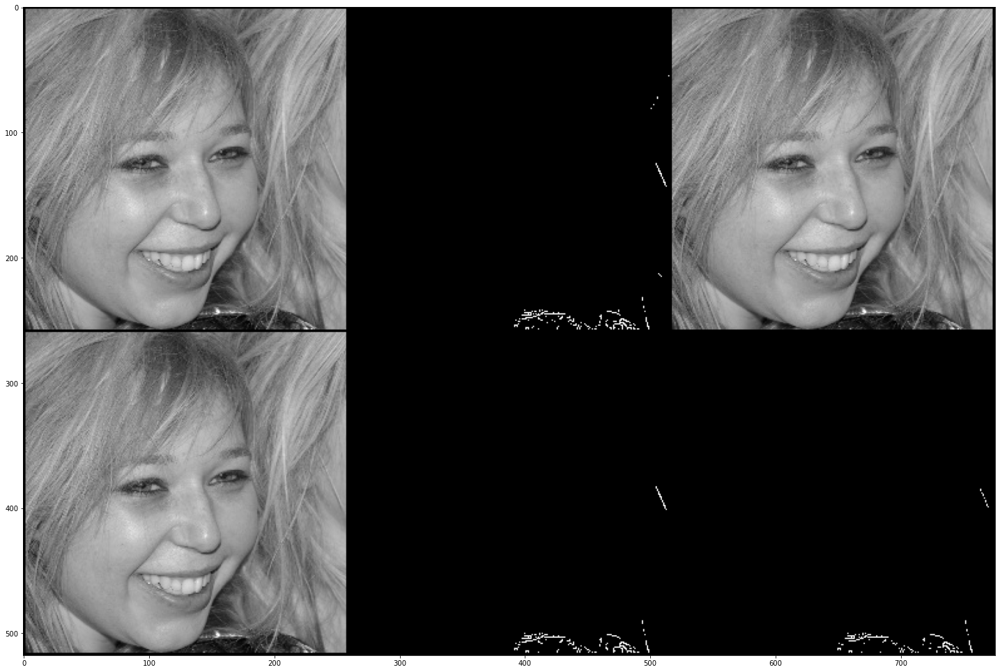

  0%|          | 13/10009 [00:06<1:20:19,  2.07it/s]

Max-Min of load image:  255 5
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 9
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


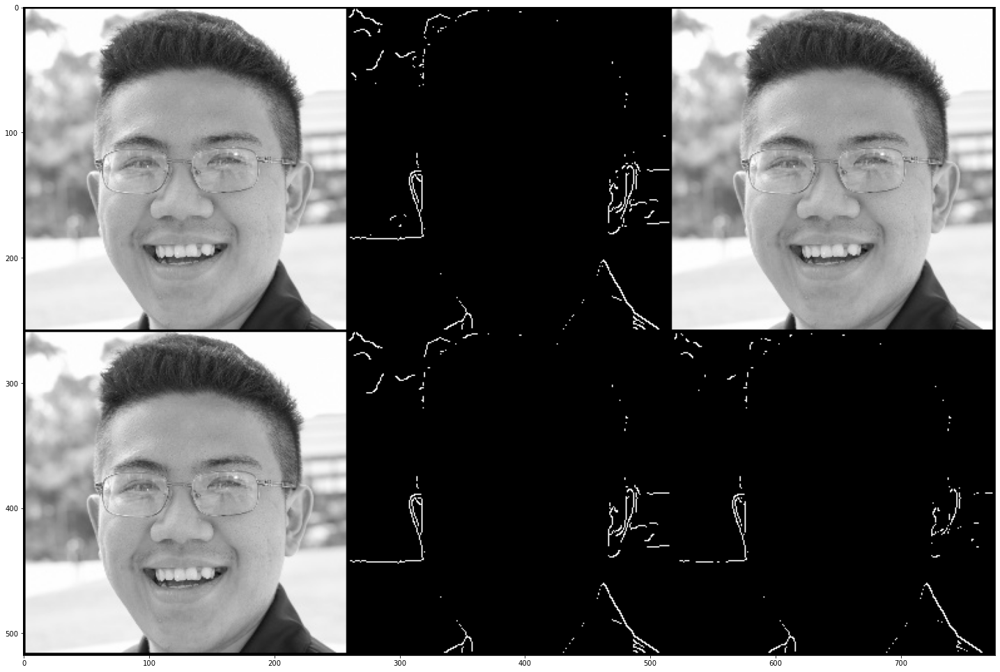

  0%|          | 14/10009 [00:06<1:17:20,  2.15it/s]

Max-Min of load image:  255 8
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 30
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


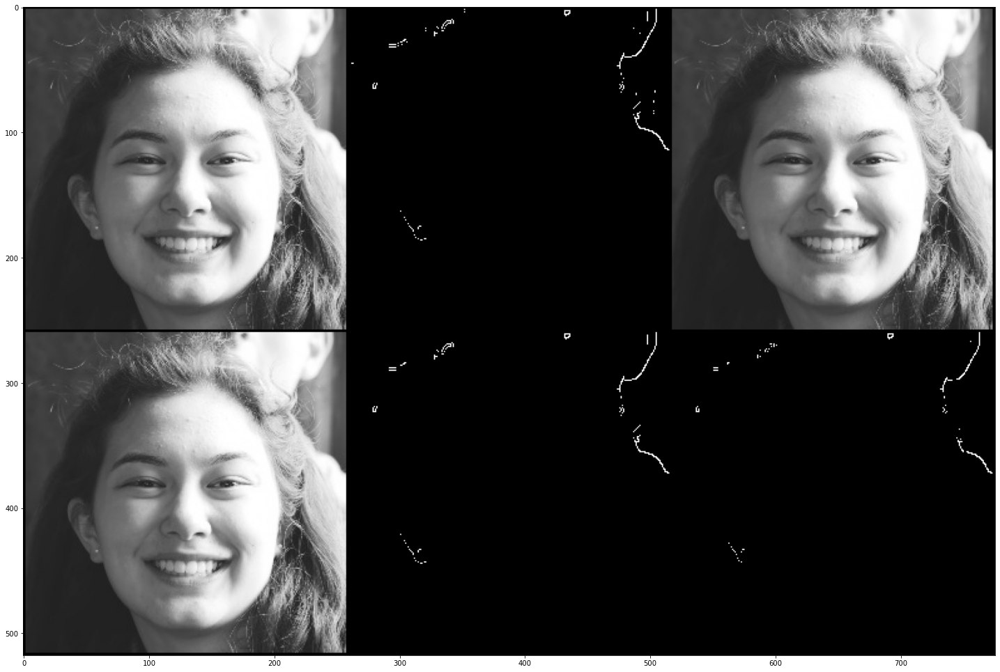

  0%|          | 15/10009 [00:06<1:14:29,  2.24it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  254 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


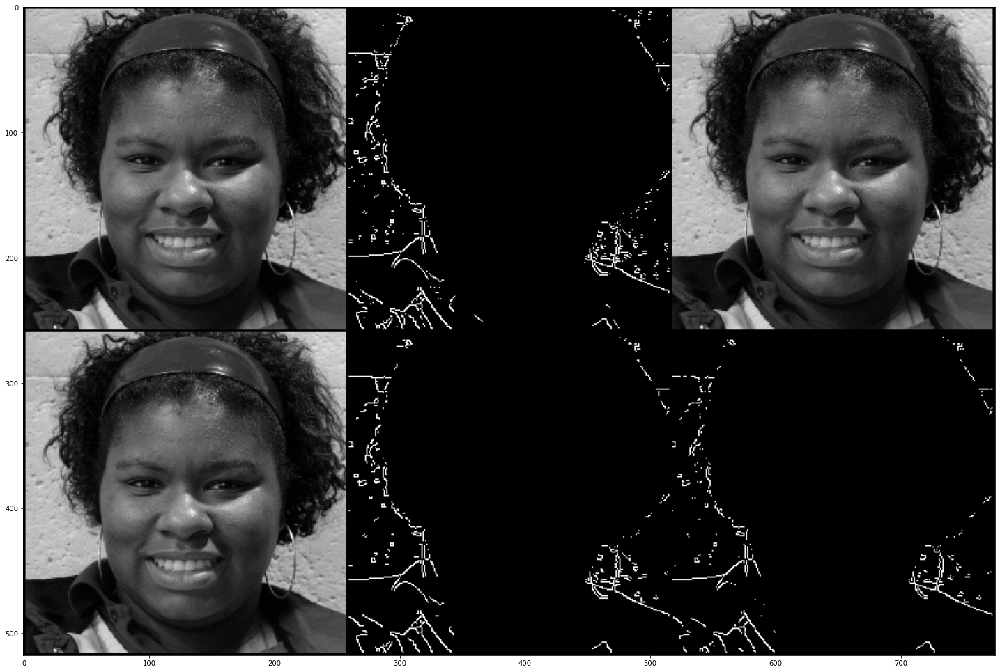

  0%|          | 16/10009 [00:07<1:14:54,  2.22it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


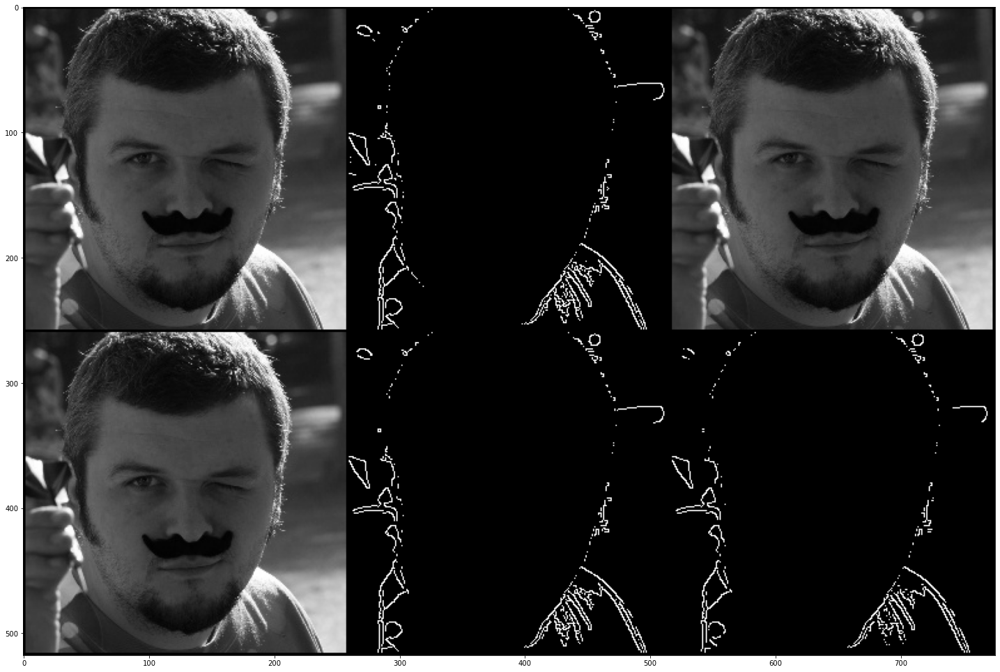

  0%|          | 17/10009 [00:07<1:13:22,  2.27it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  253 1
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


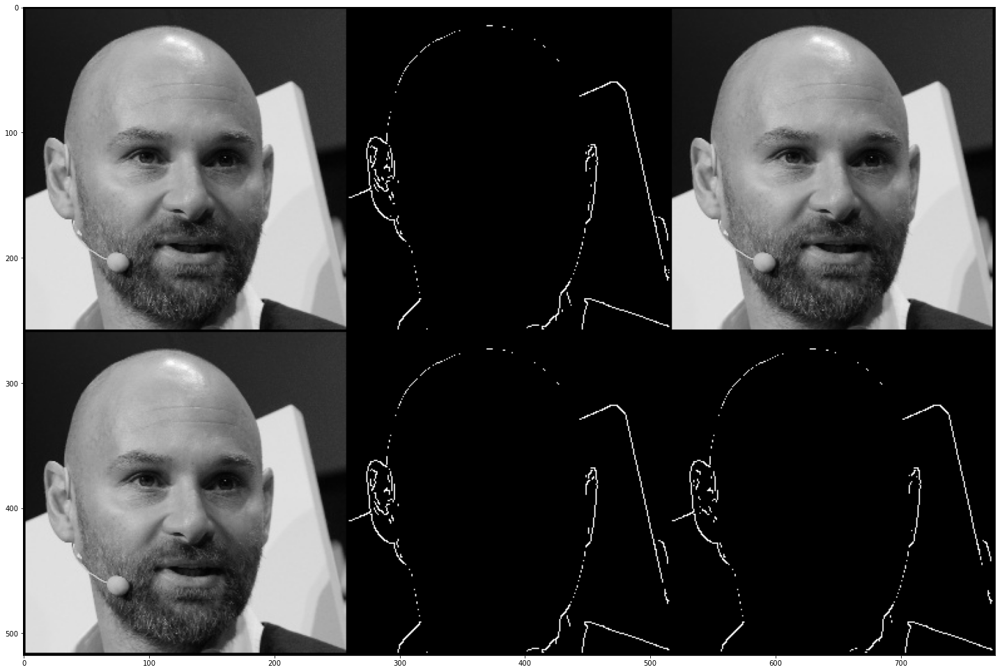

  0%|          | 18/10009 [00:08<1:11:33,  2.33it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  244 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


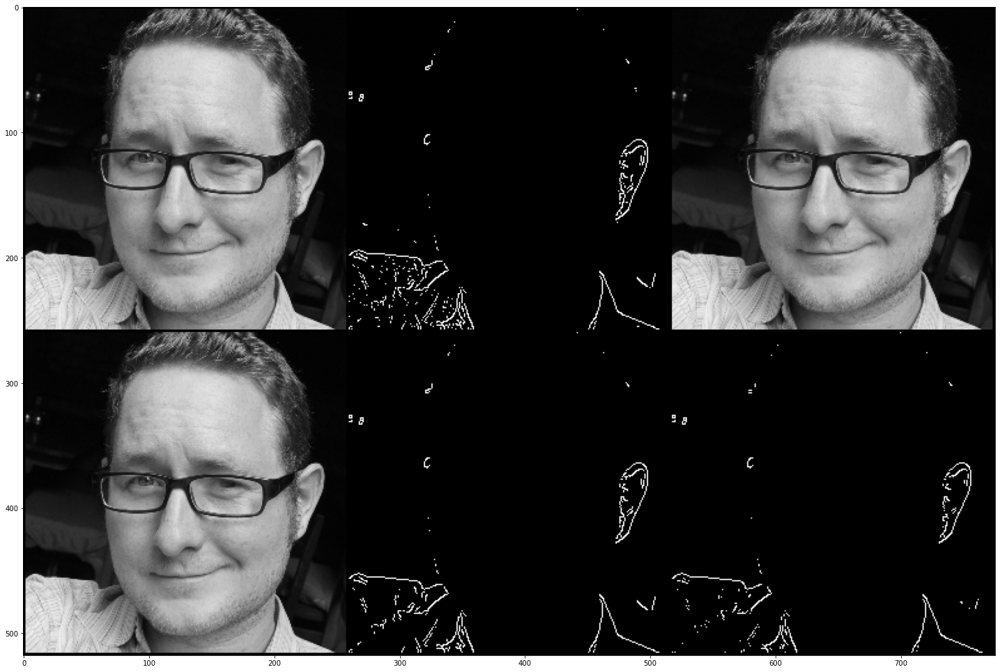

  0%|          | 19/10009 [00:08<1:11:03,  2.34it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 9
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


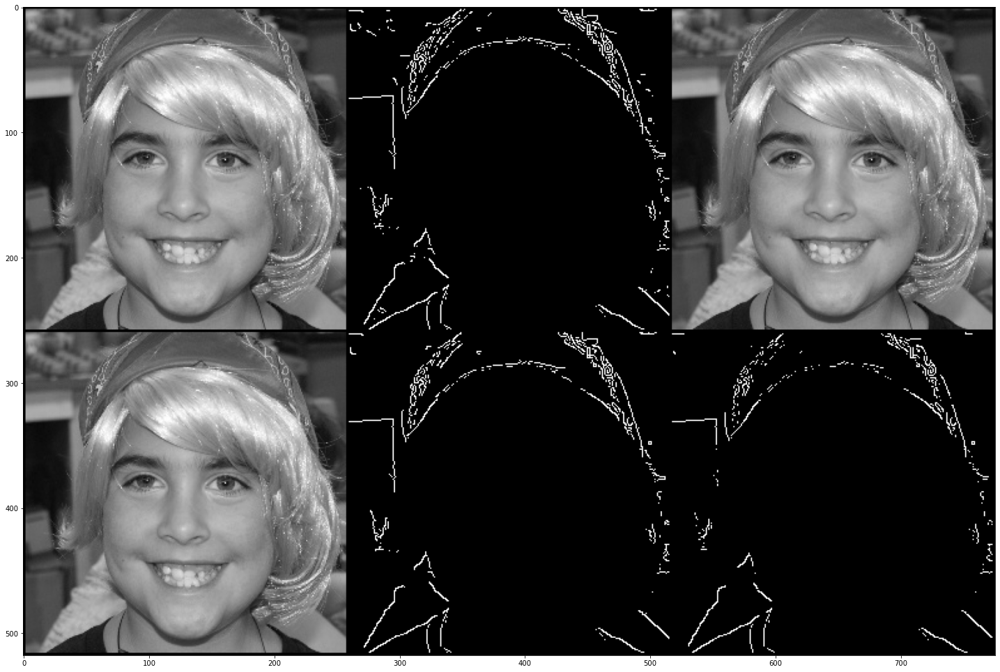

  0%|          | 20/10009 [00:09<1:13:18,  2.27it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  234 11
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


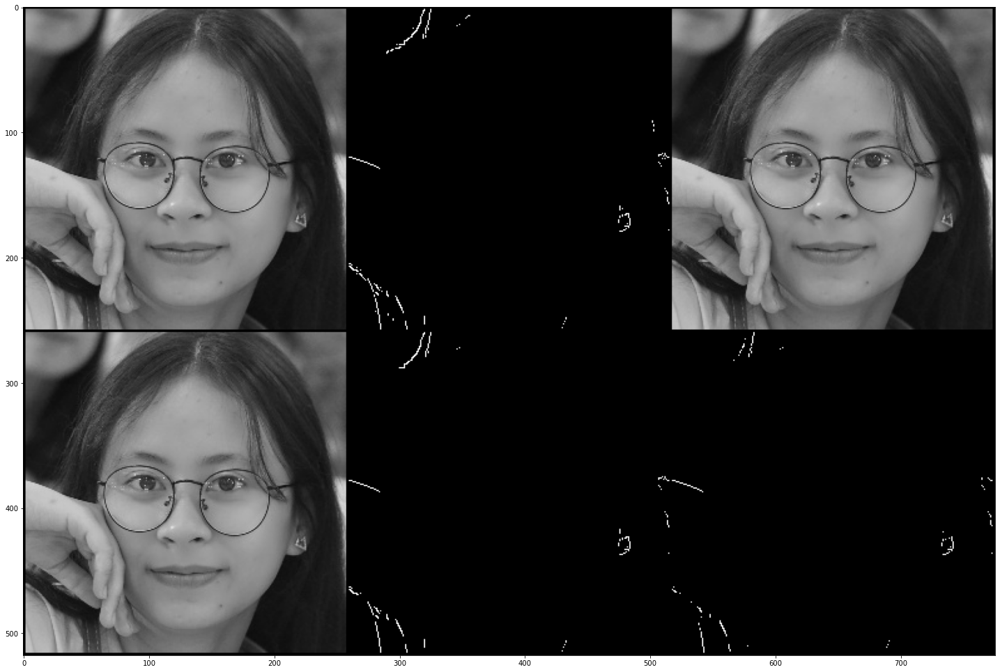

  0%|          | 21/10009 [00:09<1:18:59,  2.11it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  248 4
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


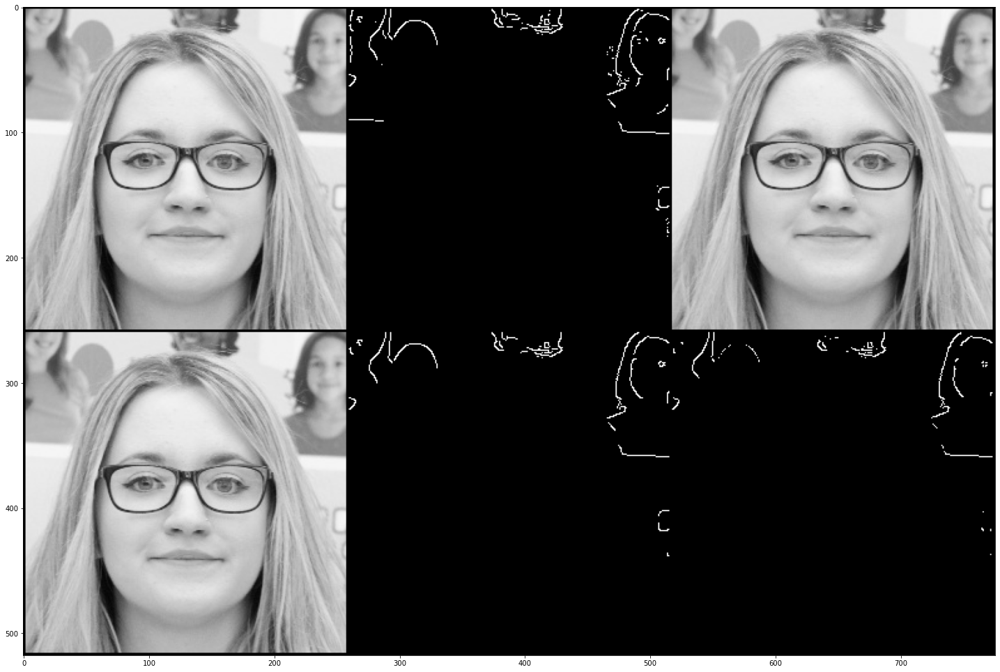

  0%|          | 22/10009 [00:10<1:17:44,  2.14it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


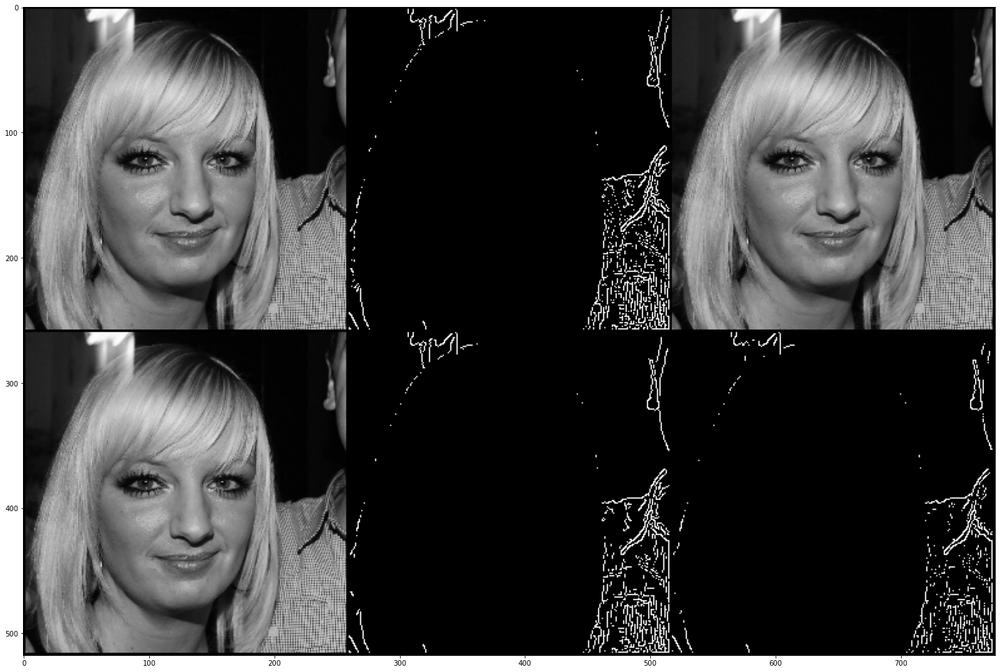

  0%|          | 23/10009 [00:10<1:16:38,  2.17it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  248 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


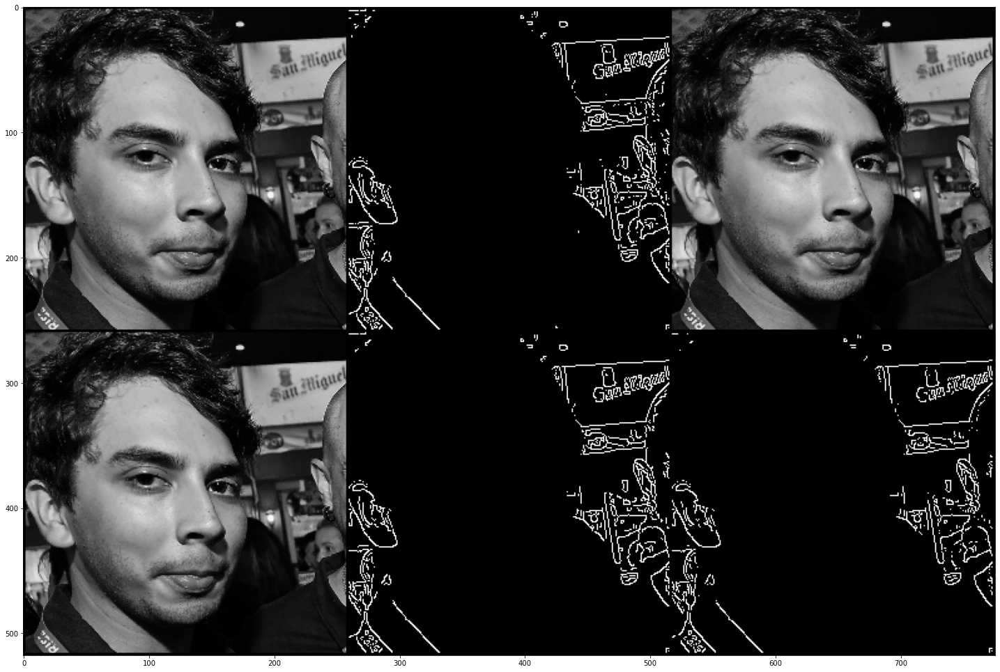

  0%|          | 24/10009 [00:10<1:15:01,  2.22it/s]

Max-Min of load image:  249 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  243 2
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


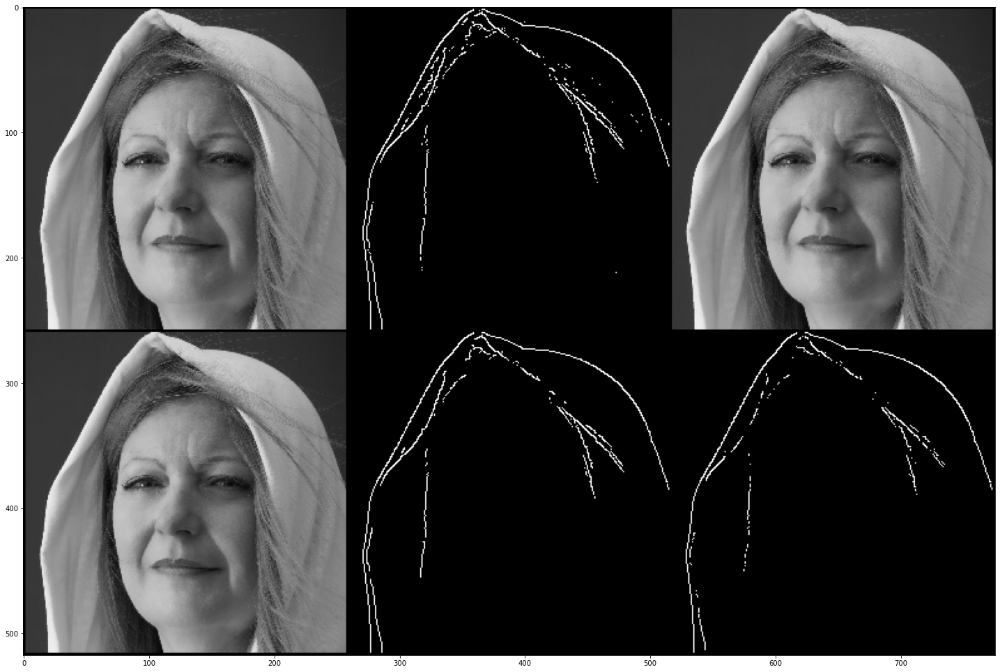

  0%|          | 25/10009 [00:11<1:12:59,  2.28it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 1
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


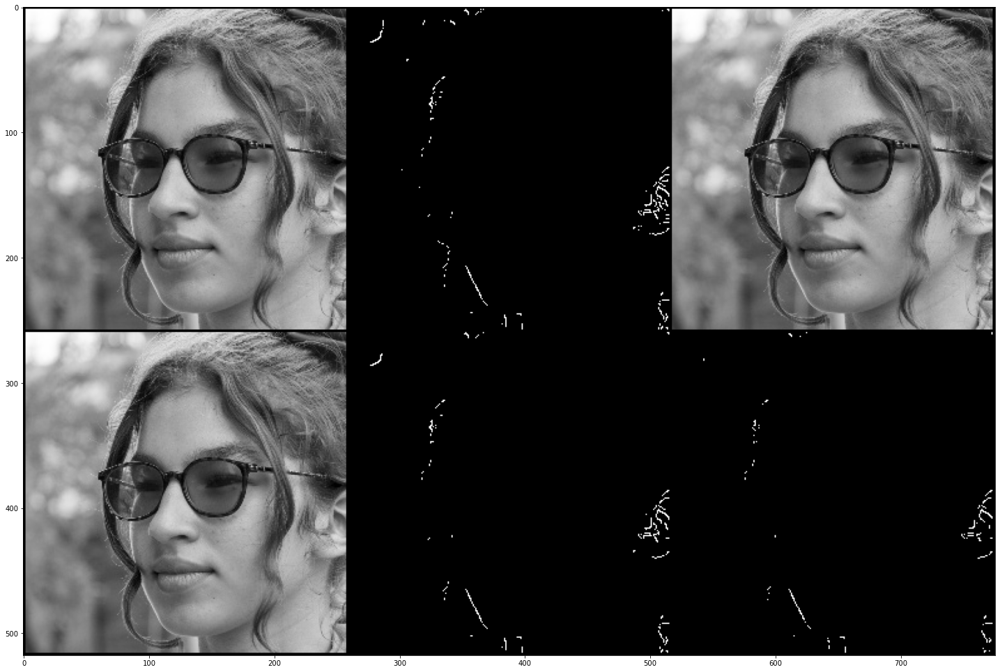

  0%|          | 26/10009 [00:11<1:12:06,  2.31it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 12
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


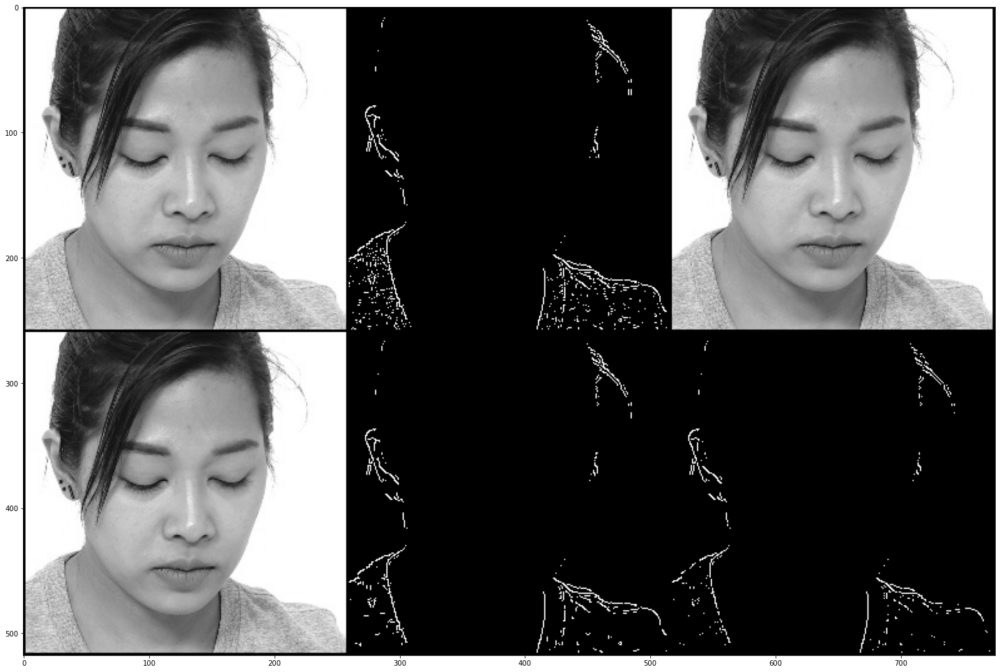

  0%|          | 27/10009 [00:12<1:12:34,  2.29it/s]

Max-Min of load image:  255 4
Img Shape:  (256, 256, 3)
Max-Min of grey image:  249 10
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


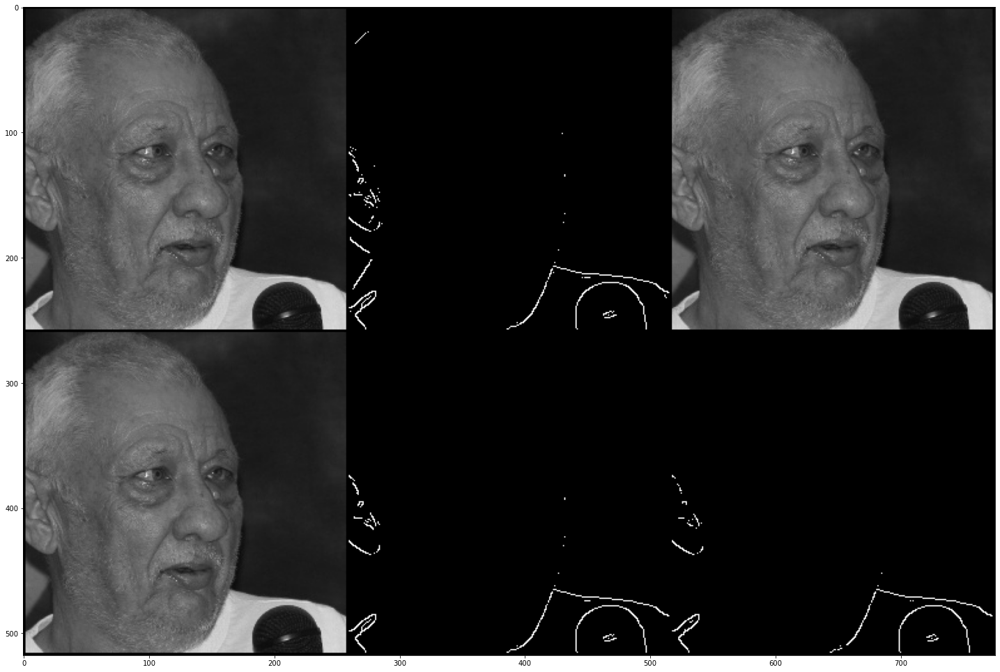

  0%|          | 28/10009 [00:12<1:14:29,  2.23it/s]

Max-Min of load image:  255 1
Img Shape:  (256, 256, 3)
Max-Min of grey image:  255 10
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


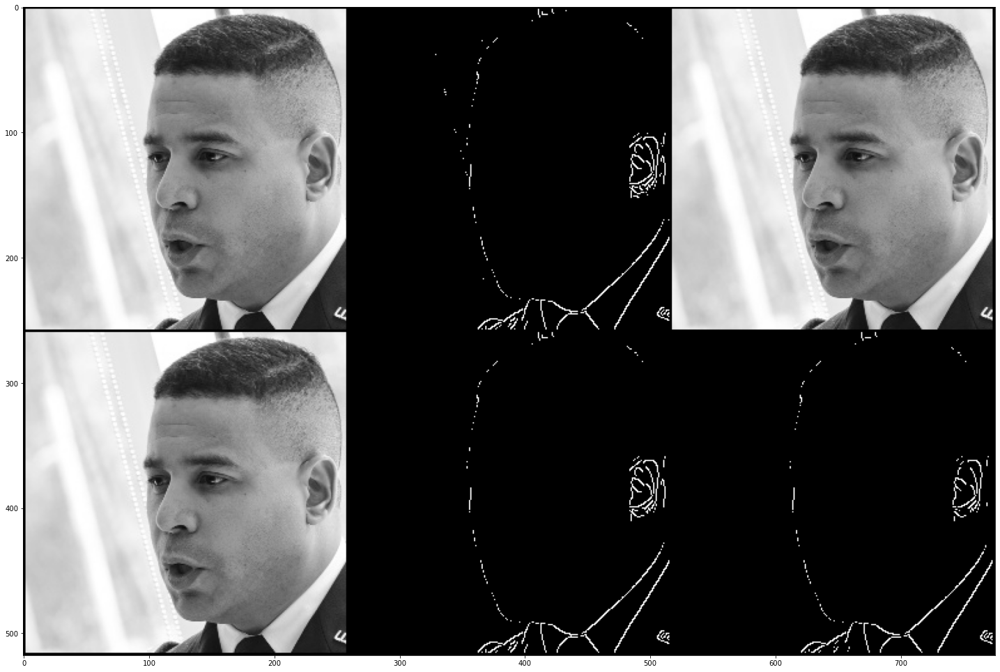

  0%|          | 29/10009 [00:13<1:15:54,  2.19it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  251 0
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


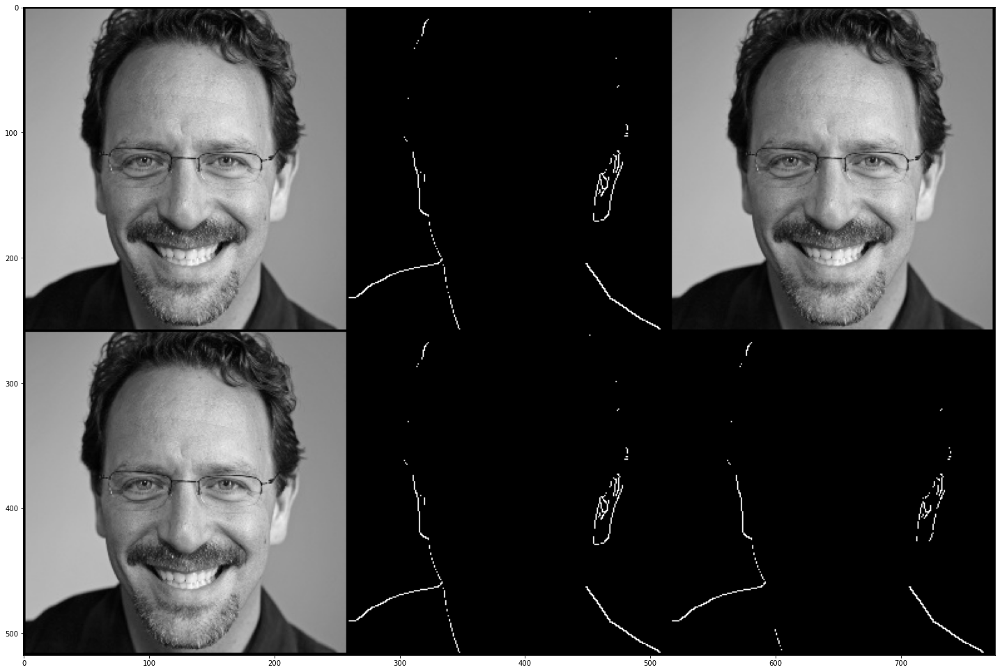

  0%|          | 30/10009 [00:13<1:14:22,  2.24it/s]

Max-Min of load image:  255 0
Img Shape:  (256, 256, 3)
Max-Min of grey image:  241 6
Grey Image Shape:  (256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
CANNY
(256, 256, 1)
torch.Size([6, 256, 256, 1])
Edges shape:  torch.Size([6, 256, 256, 1])
tensor(255.) tensor(0.)
Grid shape: torch.Size([3, 518, 776])


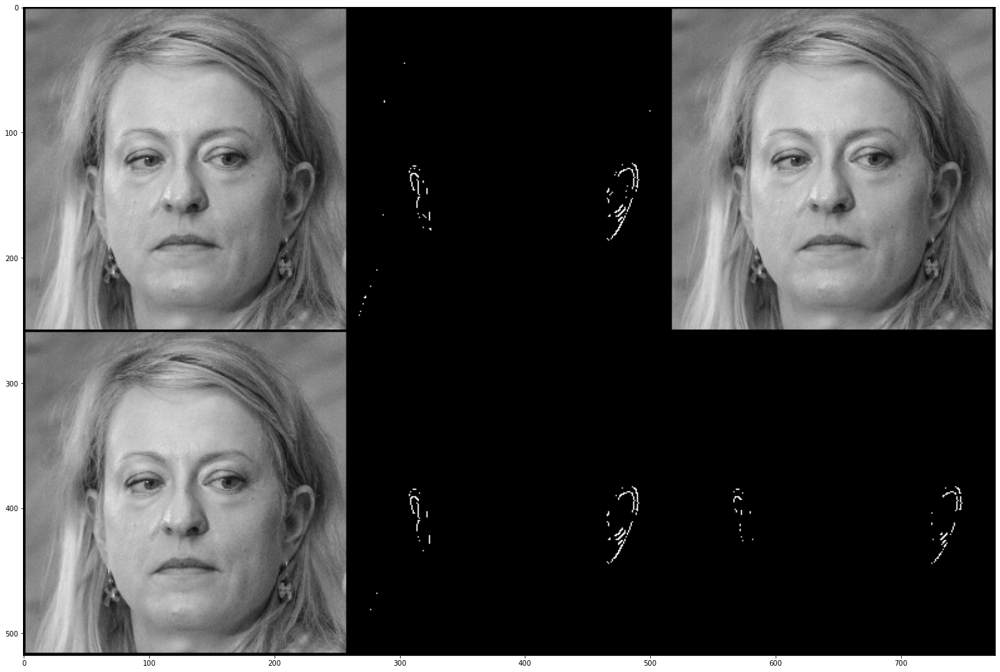

  0%|          | 30/10009 [00:14<1:17:41,  2.14it/s]


In [29]:
import torch as th
import numpy as np
import pickle
import torchvision
import matplotlib.pyplot as plt
import torch.nn.functional as F
import numpy as np
from pytorch_lightning import seed_everything
import torch as th
import tqdm
import os, glob
import cv2

set_ = 'valid'
img_file = glob.glob(f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/*.jpg")
img_size = 256
import cv2
from PIL import Image
import blobfile as bf

def sobel_edge(image, device='cuda'):
    # image is in [B, 1, H, W] format
    assert image.shape[1] == 1
    
    sobel_x = th.tensor([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype=th.float32).to(device)
    sobel_y = th.tensor([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype=th.float32).to(device)

    # Apply Sobel operators to compute gradients
    gradient_x = F.conv2d(image, sobel_x.view(1, 1, 3, 3), padding='same')
    gradient_y = F.conv2d(image, sobel_y.view(1, 1, 3, 3), padding='same')

    # Compute the magnitude of the gradient
    gradient_magnitude = th.sqrt((gradient_x**2 + gradient_y**2) + 1e-6)
    # gradient_magnitude = th.sqrt(th.clamp((gradient_x**2 + gradient_y**2), 0.0) + 1e-6)

    return gradient_x, gradient_y, gradient_magnitude

resolution = 256
mode = 'L'
img_file = [f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/69398.jpg", 
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/67400.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/60208.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/69257.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/65128.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/65169.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/66646.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/69161.jpg",
            f"/data/mint/DPM_Dataset/ffhq_256_with_anno/ffhq_256/{set_}/65203.jpg",] + img_file
for i, path in enumerate(tqdm.tqdm(img_file)):
    name = path.split('/')[-1].split('.')[0]
    with bf.BlobFile(path, "rb") as f:
        pil_image = Image.open(f)
        pil_image.load()
    
    
    path = f"/data/mint/DPM_Dataset/ffhq_256_with_anno/face_segment/{set_}/anno/anno_{name}.png"
    mask = face_segment('canny_edge_bg_mask', path)
    mask = cv2.resize(mask.astype(np.uint8), (resolution, resolution), interpolation=cv2.INTER_NEAREST)
    mask = mask[..., 0:1]
    # pil_image = pil_image.convert(mode)
    raw_img = np.array(pil_image)
    grey_img = cv2.cvtColor(raw_img[..., ::-1], cv2.COLOR_BGR2GRAY)
    img = grey_img[..., np.newaxis]
    
    print("Max-Min of load image: ", np.max(np.array(pil_image)), np.min(np.array(pil_image)))
    print("Img Shape: ", np.array(pil_image).shape)
    print("Max-Min of grey image: ", np.max(grey_img), np.min(grey_img))
    print("Grey Image Shape: ", img.shape)
    
    edges = []
    # perc = [0, 20/100 * 255, 40/100 * 255, 60/100 * 255, 80/100 * 255, 255]
    perc = [153, 204]
    # dec = [0, 51, 102, 153, 204, 255]
    for _, max_thres in enumerate(perc):
        for j, min_thres in enumerate(perc):
            if j == 0:
                edges.append(img)
            if min_thres > max_thres:
                edges.append(img)
            else:
                print("CANNY")
                print(img.shape)
                e = cv2.Canny(img, min_thres, max_thres)
                e = e[..., np.newaxis]
                e = e * mask
                edges.append(e)
    #     print("Max-Min of border_mask image: ", np.max(border_masks[j]), np.min(border_masks[j]))
    edges = th.from_numpy(np.array(edges)).float()  # B, H, W
    print(edges.shape)
    # edges = edges.unsqueeze(1)
    # edges = th.repeat_interleave(edges, 3, dim=1)
    print("Edges shape: ", edges.shape)
    # Visualize all gradients
    plt.figure(figsize=(25, 25))
    # border_masks = np.concatenate(edge_masks, axis=2)
    
    # edges = edges.cpu().numpy().astype(np.uint8)
    edges = np.transpose(edges, (0, 3, 1, 2))
    grid = torchvision.utils.make_grid(edges, nrow=len(perc)+1)
    print(th.max(grid), th.min(grid))
    print("Grid shape:", grid.shape)
    # plt.imshow(img)
    plt.imshow(grid.cpu().numpy().astype(np.uint8).transpose(1, 2, 0))
    
    # plt.imshow(np.concatenate((img, edges), axis=1), cmap='gray')
    # plt.imshow(np.concatenate(((img[0] * 255).cpu().numpy().transpose(1, 2, 0), border_masks.transpose(1, 2, 0), gmag_orig.transpose(1, 2, 0)), axis=1), cmap='gray')
    plt.show()
    if i == 30: break
    